**Importing (and/or installing) all the libraries needed for this project**

In [1]:
# Libraries

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
#import plotly.io as pio

import re

#from jupyterthemes import jtplot
#jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False) 
# setting the style of the notebook to be monokai theme  
# this theme helps make the x and y axes labels clearly on plots which are black on black

from PIL import Image

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.feature_extraction.text import CountVectorizer

import nltk
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize

nltk.download('punkt')

from bs4 import BeautifulSoup

import string
from string import punctuation
from collections import Counter

import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS

import tensorflow as tf 
from tensorflow.keras.preprocessing.text import one_hot, Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional, LSTM, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam

[nltk_data] Downloading package punkt to /Users/MMbA/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


**Importing, viewing and wrangling both real and fake news datasets**

In [3]:
# Load both real and fake news data files
df_real = pd.read_csv("../data/True.csv")
df_fake = pd.read_csv("../data/Fake.csv")

In [4]:
# Dimensions of the news datasets
print(df_real.shape)
print(df_fake.shape)

(21417, 4)
(23481, 4)


In [5]:
# Quick summary of real news dataset
df_real.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21417 entries, 0 to 21416
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    21417 non-null  object
 1   text     21417 non-null  object
 2   subject  21417 non-null  object
 3   date     21417 non-null  object
dtypes: object(4)
memory usage: 669.4+ KB


In [6]:
# Quick summary of fake news dataset
df_fake.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23481 entries, 0 to 23480
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    23481 non-null  object
 1   text     23481 non-null  object
 2   subject  23481 non-null  object
 3   date     23481 non-null  object
dtypes: object(4)
memory usage: 733.9+ KB


In [7]:
print("Number of rows in real news dataframe: ", len(df_real))
print("Number of rows in fake news dataframe: ", len(df_fake))

Number of rows in real news dataframe:  21417
Number of rows in fake news dataframe:  23481


In [8]:
print("Number of Null rows in real news dataframe: ", df_real.isnull().sum())
print("\r")
print("Number of Null rows in fake news dataframe: ", df_fake.isnull().sum())

Number of Null rows in real news dataframe:  title      0
text       0
subject    0
date       0
dtype: int64

Number of Null rows in fake news dataframe:  title      0
text       0
subject    0
date       0
dtype: int64


In [9]:
# View true news data 
df_real.head(10)

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017"
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017"
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017"
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017"


In [10]:
# View fake news data 
df_fake.head(10)

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017"
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017"
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017"
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017"
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017"


In [11]:
# Add a isfake target column to real news df to indicate whether the news is real ie isfake=0 (not fake)
print("Real news data")
df_real['isfake'] = 0 
df_real.head(10)

Real news data


,title,text,subject,date,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",0
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",0
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",0
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",0
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",0
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,"December 29, 2017",0
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,"December 29, 2017",0
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,"December 29, 2017",0
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,"December 29, 2017",0
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,"December 28, 2017",0


In [12]:
# Add a isfake target column to fake news df to indicate whether the news is real ie isfake=1 (is fake)
print("Fake news data")
df_fake['isfake'] = 1
df_fake.head(10)

Fake news data


,title,text,subject,date,isfake
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",1
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",1
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",1
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",1
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",1
5,Racist Alabama Cops Brutalize Black Boy While...,The number of cases of cops brutalizing and ki...,News,"December 25, 2017",1
6,"Fresh Off The Golf Course, Trump Lashes Out A...",Donald Trump spent a good portion of his day a...,News,"December 23, 2017",1
7,Trump Said Some INSANELY Racist Stuff Inside ...,In the wake of yet another court decision that...,News,"December 23, 2017",1
8,Former CIA Director Slams Trump Over UN Bully...,Many people have raised the alarm regarding th...,News,"December 22, 2017",1
9,WATCH: Brand-New Pro-Trump Ad Features So Muc...,Just when you might have thought we d get a br...,News,"December 21, 2017",1


In [13]:
# Function to count the total twitter username mentions 
def twitter_username_count(df):
    twitter_username = re.compile(r'@([A-Za-z0-9_]+)')
    count = 0
    list_ = []
    for name in df['text']:
        count += len(re.findall(twitter_username, name))
    return count

In [14]:
# Checking the total number of twitter username mentions in both datasets
twitter_fake_usernames = twitter_username_count(df_fake)
twitter_real_usernames = twitter_username_count(df_real)

print("The number of twitter usernames in the real data: " + str(twitter_real_usernames))
print("The number of twitter usernames in the fake data: " + str(twitter_fake_usernames))

The number of twitter usernames in the real data: 803
The number of twitter usernames in the fake data: 27886


- An interesting initial observation is the number of mentions of @ twitter users in the fake news dataset compared to the real dataset. This could be considered as a bias in the fake dataset, but preprocessing the news datasets would remove this bias anyway.


In [15]:
# Join both real and fake news into 1 dataset and reset the index
df_allnews = pd.concat([df_real, df_fake]).reset_index(drop = True)
df_allnews

,title,text,subject,date,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",0
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",0
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017",0
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017",0
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017",0
...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,"January 16, 2016",1
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,"January 16, 2016",1
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,"January 15, 2016",1
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,"January 14, 2016",1


In [16]:
# Get rid of date column (provides no value during for this project). 
# Inplace=true to make sure the column is dropped permanently in memory as well.
df_allnews.drop(columns = ['date'], inplace = True)
df_allnews

,title,text,subject,isfake
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,0
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,0
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,0
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,0
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,0
...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,1
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,1
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,1
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,1


**Visualizing the distribution of real and fake articles in the data**

[Text(0.5, 0, 'Article Type')]

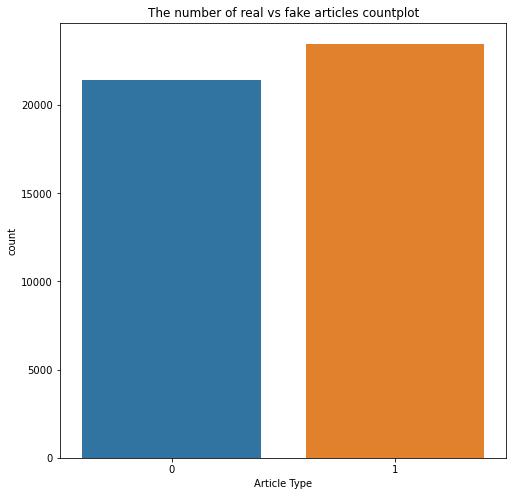

In [17]:
# Countplot of the breakdown in the subject column 
# Notice the plot shows that the dataset is almost balanced between real and fake news
plt.figure(figsize = (8, 8))
ax = sns.countplot(data = df_allnews, x = "isfake")
ax.set_title("The number of real vs fake articles countplot")
ax.set(xlabel = "Article Type")

- Notice how the dataset of real and fake news articles are pretty much balanced

[Text(0, 0.5, 'Count')]

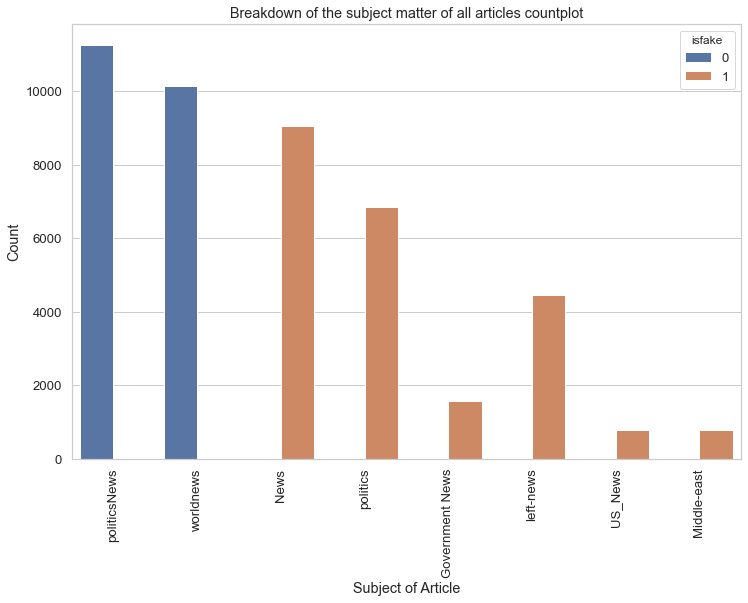

In [18]:
# Countplot of the breakdown of samples in the subject column
plt.figure(figsize = (12, 8))
sns.set(style = "whitegrid",font_scale = 1.2)
ax2 = sns.countplot(data = df_allnews, x = "subject", hue = "isfake")
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=90)
ax2.set_title("Breakdown of the subject matter of all articles countplot")
ax2.set(xlabel = "Subject of Article")
ax2.set(ylabel = "Count")

- Notice how the categories are distributed along real and fake articles. This will ultimately correlate with the classification of real or fake articles and will easily be picked up by the prediction model. Thus, categories will not be combined with the fullarticle below.

**Cleaning the data**

In [19]:
# Combine title and body of news article together into a new column called fullarticle
df_allnews['fullarticle'] = df_allnews['title'] + ' ' + df_allnews['text']
df_allnews.head(10)

,title,text,subject,isfake,fullarticle
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,0,"As U.S. budget fight looms, Republicans flip t..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,0,U.S. military to accept transgender recruits o...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,0,Senior U.S. Republican senator: 'Let Mr. Muell...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,0,FBI Russia probe helped by Australian diplomat...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,0,Trump wants Postal Service to charge 'much mor...
5,"White House, Congress prepare for talks on spe...","WEST PALM BEACH, Fla./WASHINGTON (Reuters) - T...",politicsNews,0,"White House, Congress prepare for talks on spe..."
6,"Trump says Russia probe will be fair, but time...","WEST PALM BEACH, Fla (Reuters) - President Don...",politicsNews,0,"Trump says Russia probe will be fair, but time..."
7,Factbox: Trump on Twitter (Dec 29) - Approval ...,The following statements were posted to the ve...,politicsNews,0,Factbox: Trump on Twitter (Dec 29) - Approval ...
8,Trump on Twitter (Dec 28) - Global Warming,The following statements were posted to the ve...,politicsNews,0,Trump on Twitter (Dec 28) - Global Warming The...
9,Alabama official to certify Senator-elect Jone...,WASHINGTON (Reuters) - Alabama Secretary of St...,politicsNews,0,Alabama official to certify Senator-elect Jone...


In [20]:
# Check to make sure that the title and body are combined into 1 column 
df_allnews['fullarticle'][0]

'As U.S. budget fight looms, Republicans flip their fiscal script WASHINGTON (Reuters) - The head of a conservative Republican faction in the U.S. Congress, who voted this month for a huge expansion of the national debt to pay for tax cuts, called himself a “fiscal conservative” on Sunday and urged budget restraint in 2018. In keeping with a sharp pivot under way among Republicans, U.S. Representative Mark Meadows, speaking on CBS’ “Face the Nation,” drew a hard line on federal spending, which lawmakers are bracing to do battle over in January. When they return from the holidays on Wednesday, lawmakers will begin trying to pass a federal budget in a fight likely to be linked to other issues, such as immigration policy, even as the November congressional election campaigns approach in which Republicans will seek to keep control of Congress. President Donald Trump and his Republicans want a big budget increase in military spending, while Democrats also want proportional increases for non

**Downloading the stopwords** 
- i.e. words which do not add much meaning to a sentence and can safely be removed without sacrificing the meaning of the sentence. For example words such as: the, he, have etc. 

In [21]:
# Download stopwords
nltk.download("stopwords")

[nltk_data] Downloading package stopwords to /Users/MMbA/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [22]:
# Adding stopwords
stop_words = set(stopwords.words('english'))
#stop_words

# Adding punctuation to the stopwords list
punctuation = list(string.punctuation)
stop_words.update(punctuation)
#stop_words

**Preprocessing the data**

In [23]:
# Lets pre-clean the article text a little
# Remove html elements  
def remove_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

# Remove square brackets with Regular Expression
def remove_square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)

# Remove URLs with Regular Expression
def remove_urls(text):
    return re.sub(r'http\S+', '', text)

def lowercase(text):
    return text.lower()

def remove_stopwords(text):
    final_text = []
    for i in text.split():
        if i.strip().lower() not in stop_words:
            final_text.append(i.strip())
    return " ".join(final_text)

def lemmatize(text):
    lemm = nltk.stem.WordNetLemmatizer()
    return lemm.lemmatize(text)
    #return [lemm.lemmatize(text) for word in text if word not in stop_words]

# Pre-cleaning of text
def pre_clean(text):
    text = remove_html(text)
    text = remove_square_brackets(text)
    text = remove_urls(text)
    text = lowercase(text)
    text = remove_stopwords(text)
    text = lemmatize(text)
    return text




# Apply pre-clean function
df_allnews['clean'] = df_allnews['fullarticle'].apply(pre_clean)

In [24]:
# Comparing the cleaned data to the original
print(df_allnews['clean'][0])

u.s. budget fight looms, republicans flip fiscal script washington (reuters) head conservative republican faction u.s. congress, voted month huge expansion national debt pay tax cuts, called “fiscal conservative” sunday urged budget restraint 2018. keeping sharp pivot way among republicans, u.s. representative mark meadows, speaking cbs’ “face nation,” drew hard line federal spending, lawmakers bracing battle january. return holidays wednesday, lawmakers begin trying pass federal budget fight likely linked issues, immigration policy, even november congressional election campaigns approach republicans seek keep control congress. president donald trump republicans want big budget increase military spending, democrats also want proportional increases non-defense “discretionary” spending programs support education, scientific research, infrastructure, public health environmental protection. “the (trump) administration already willing say: ‘we’re going increase non-defense discretionary spe

In [25]:
print(df_allnews['fullarticle'][0])

As U.S. budget fight looms, Republicans flip their fiscal script WASHINGTON (Reuters) - The head of a conservative Republican faction in the U.S. Congress, who voted this month for a huge expansion of the national debt to pay for tax cuts, called himself a “fiscal conservative” on Sunday and urged budget restraint in 2018. In keeping with a sharp pivot under way among Republicans, U.S. Representative Mark Meadows, speaking on CBS’ “Face the Nation,” drew a hard line on federal spending, which lawmakers are bracing to do battle over in January. When they return from the holidays on Wednesday, lawmakers will begin trying to pass a federal budget in a fight likely to be linked to other issues, such as immigration policy, even as the November congressional election campaigns approach in which Republicans will seek to keep control of Congress. President Donald Trump and his Republicans want a big budget increase in military spending, while Democrats also want proportional increases for non-

In [26]:
# Showing the updated dataset
df_allnews

,title,text,subject,isfake,fullarticle,clean
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,0,"As U.S. budget fight looms, Republicans flip t...","u.s. budget fight looms, republicans flip fisc..."
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,0,U.S. military to accept transgender recruits o...,u.s. military accept transgender recruits mond...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,0,Senior U.S. Republican senator: 'Let Mr. Muell...,senior u.s. republican senator: 'let mr. muell...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,0,FBI Russia probe helped by Australian diplomat...,fbi russia probe helped australian diplomat ti...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,0,Trump wants Postal Service to charge 'much mor...,trump wants postal service charge 'much more' ...
...,...,...,...,...,...,...
44893,McPain: John McCain Furious That Iran Treated ...,21st Century Wire says As 21WIRE reported earl...,Middle-east,1,McPain: John McCain Furious That Iran Treated ...,mcpain: john mccain furious iran treated us sa...
44894,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,21st Century Wire says It s a familiar theme. ...,Middle-east,1,JUSTICE? Yahoo Settles E-mail Privacy Class-ac...,justice? yahoo settles e-mail privacy class-ac...
44895,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,Patrick Henningsen 21st Century WireRemember ...,Middle-east,1,Sunnistan: US and Allied ‘Safe Zone’ Plan to T...,sunnistan: us allied ‘safe zone’ plan take ter...
44896,How to Blow $700 Million: Al Jazeera America F...,21st Century Wire says Al Jazeera America will...,Middle-east,1,How to Blow $700 Million: Al Jazeera America F...,blow $700 million: al jazeera america finally ...


**Visualizing data**

**Word clouds!**
- Word cloud are a visualization of the most common single words in a dataset. The most frequent words are shown by the font size or color.

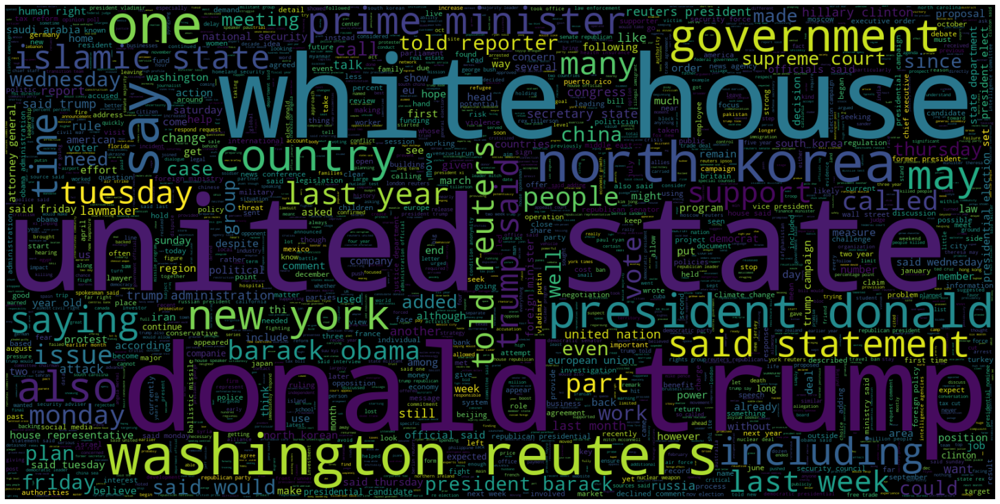

In [27]:
# Creating a word cloud plot for articles that are real (isfake = 0)
plt.figure(figsize = (20, 20)) 
wc = WordCloud(max_words = 2000, width = 1600, height = 800, 
               stopwords = stop_words).generate(" ".join(df_allnews[df_allnews.isfake == 0].clean))
plt.imshow(wc, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad = 0) 
plt.show()

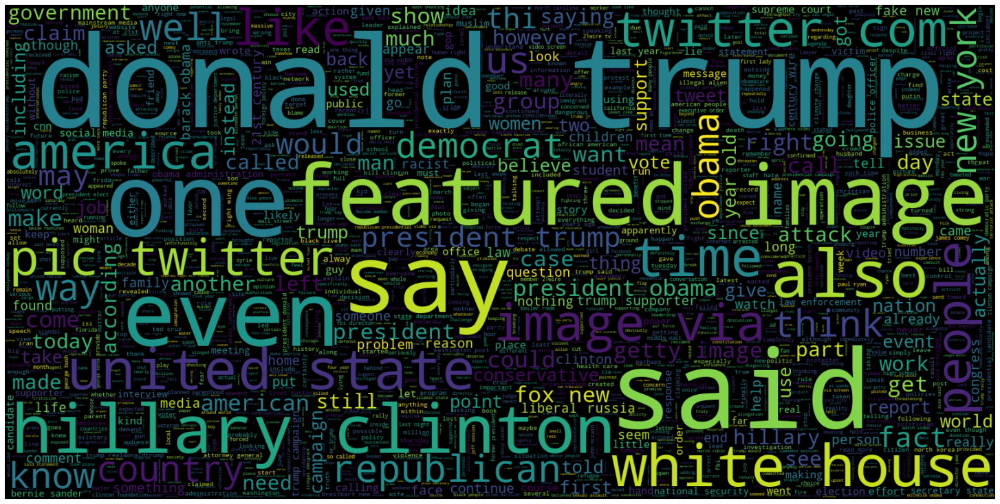

In [28]:
# Creating a word cloud plot for articles that are fake (isfake = 1)
plt.figure(figsize = (20, 20)) 
wc = WordCloud(max_words = 2000, width = 1600, height = 800, 
               stopwords = stop_words).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean))
plt.imshow(wc, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad = 0) 
plt.show()

- Lets have some fun with word clouds

In [29]:
# Creating a custom word cloud plot for articles that are fake (isfake = 1)
mask = np.array(Image.open('../imgs/USACanada_BlankMap.png'))

wc_fun = WordCloud(stopwords = stop_words, mask = mask, background_color = "white", 
               max_words = 2000, max_font_size = 256, contour_width = 2, contour_color = 'lightgrey',
               random_state = 42).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean))
               #width=mask.shape[1], 
               #height=mask.shape[0]).generate(" ".join(df_allnews[df_allnews.isfake == 1].clean))
#wc.generate(article.text)
plt.figure(figsize=[200,100])
plt.imshow(wc_fun, interpolation="bilinear")
plt.axis('off')
plt.tight_layout(pad = 0) 
plt.show()

In [30]:
# Creating a custom word cloud plot for articles that are real (isfake = 0)
wc_fun = WordCloud(stopwords = stop_words, mask = mask, background_color = "white",
               max_words = 2000, max_font_size = 256, contour_width = 3, contour_color = 'lightgrey',
               random_state = 42).generate(" ".join(df_allnews[df_allnews.isfake == 0].clean))
               #width=mask.shape[1], 
               #height=mask.shape[0]).generate(" ".join(df_allnews[df_allnews.isfake == 0].clean))
#wc.generate(article.text)
plt.figure(figsize=[200,100])
plt.imshow(wc_fun, interpolation="bilinear")
plt.axis('off')
plt.tight_layout(pad = 0) 
plt.show()

In [32]:
# Creating tokens ie breaking up into unique words
print(nltk.word_tokenize(df_allnews['clean'][1]))

['u.s.', 'military', 'accept', 'transgender', 'recruits', 'monday', ':', 'pentagon', 'washington', '(', 'reuters', ')', 'transgender', 'people', 'allowed', 'first', 'time', 'enlist', 'u.s.', 'military', 'starting', 'monday', 'ordered', 'federal', 'courts', ',', 'pentagon', 'said', 'friday', ',', 'president', 'donald', 'trump', '’', 's', 'administration', 'decided', 'appeal', 'rulings', 'blocked', 'transgender', 'ban', '.', 'two', 'federal', 'appeals', 'courts', ',', 'one', 'washington', 'one', 'virginia', ',', 'last', 'week', 'rejected', 'administration', '’', 's', 'request', 'put', 'hold', 'orders', 'lower', 'court', 'judges', 'requiring', 'military', 'begin', 'accepting', 'transgender', 'recruits', 'jan.', '1.', 'justice', 'department', 'official', 'said', 'administration', 'challenge', 'rulings', '.', '“', 'the', 'department', 'defense', 'announced', 'releasing', 'independent', 'study', 'issues', 'coming', 'weeks', '.', 'rather', 'litigate', 'interim', 'appeal', 'occurs', ',', 'admi

In [33]:
# Getting the maximum article length. 
max_len = -1
for article in df_allnews.clean:
    tokens = nltk.word_tokenize(article) # creates the tokens ie every unique word
    if(max_len < len(tokens)):
        max_len = len(tokens)
print("The maximum number of words in any article is =", max_len)

The maximum number of words in any article is = 5729


In [34]:
# Using plotly to create a histogram (interactable) for the distribution of number of words in an article
maxLengthPlot = px.histogram(x = [len(nltk.word_tokenize(x)) for x in df_allnews.clean], 
                             title='Distribution of Total Number of Words Per Article', 
                             labels={'x':'Number of Words Per Article'}, nbins = 100)
maxLengthPlot.show("notebook") # Forces the notebook renderer to reload to show plot

- Notice articles with 200-299 words make up the peak of all the articles

- Now let's look at the distribution of the number of characters in the articles 

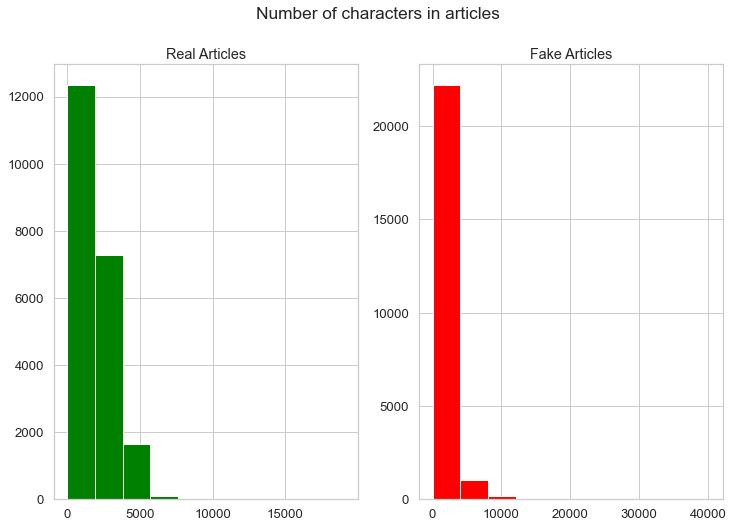

In [35]:
# Plots which show the number of characters in both real and fake articles
fig,(ax1,ax2) = plt.subplots(1, 2, figsize = (12, 8))
article_length = df_allnews[df_allnews['isfake'] == 0]['clean'].str.len()
ax1.hist(article_length, color = 'green')
ax1.set_title('Real Articles')
article_length = df_allnews[df_allnews['isfake'] == 1]['clean'].str.len()
ax2.hist(article_length, color = 'red')
ax2.set_title('Fake Articles')
fig.suptitle('Number of characters in articles')
plt.show()

- The distribution of the most common number of characters in both real and fake articles are different from each other.

- Number of words in real and fake articles

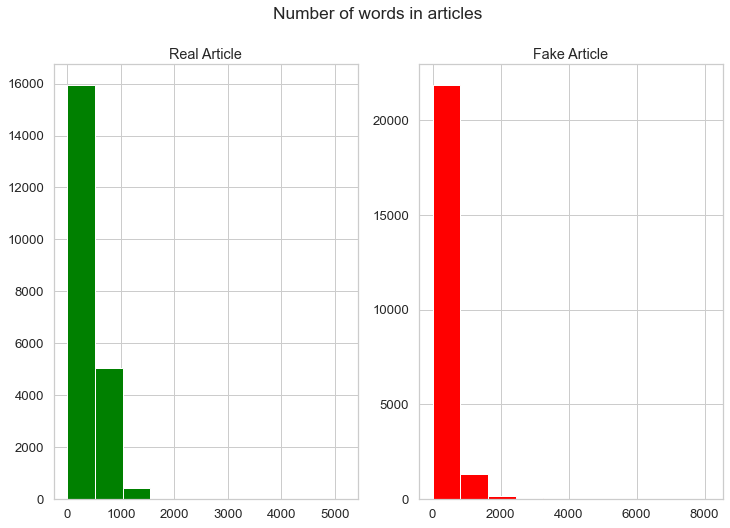

In [36]:
# Plots which show the number of words in both real and fake articles
fig,(ax1,ax2) = plt.subplots(1, 2, figsize = (12, 8))
article_length = df_allnews[df_allnews['isfake'] == 0]['text'].str.split().map(lambda x: len(x))
ax1.hist(article_length,color = 'green')
ax1.set_title('Real Article')
article_length = df_allnews[df_allnews['isfake'] == 1]['text'].str.split().map(lambda x: len(x))
ax2.hist(article_length,color = 'red')
ax2.set_title('Fake Article')
fig.suptitle('Number of words in articles')
plt.show()

- Again, notice that real and fake articles have different average word lengths 

- Let's look at the top 30 words in both real and fake articles

In [38]:
# Top 30 words in the real articles
df_news_real = pd.DataFrame(pd.Series(' '.join(df_allnews[df_allnews['isfake'] == 0]['clean']).split()).value_counts()).head(30)

plot_data = [
    go.Bar(
        x = df_news_real.index,
        y = df_news_real[0],
        marker = dict(color = df_news_real[0])
    )
]
plot_layout = go.Layout(
        title='Top 30 words from real news',
        yaxis_title='Count',
        xaxis_title='Word',
        plot_bgcolor='rgba(0,0,0,0)'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyo.iplot(fig)

In [39]:
# Top 30 words in the fake articles
df_news_fake = pd.DataFrame(pd.Series(' '.join(df_allnews[df_allnews['isfake'] == 1]['clean']).split()).value_counts()).head(30)

plot_data = [
    go.Bar(
        x = df_news_fake.index,
        y = df_news_fake[0],
        marker = dict(color = df_news_fake[0])
    )
]
plot_layout = go.Layout(
        title='Top 30 words from fake news',
        yaxis_title='Count',
        xaxis_title='Word',
        plot_bgcolor='rgba(0,0,0,0)'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyo.iplot(fig)

In [40]:
# Function to create a corpus and count the frequency of each word in all the articles
# Dsiplay 1st 5 words in the corpus
def get_corpus(text):
    words = []
    for i in text:
        for j in i.split():
            words.append(j.strip())
    return words
corpus = get_corpus(df_allnews.clean)
corpus[:5]

['u.s.', 'budget', 'fight', 'looms,', 'republicans']

In [41]:
# Check the most common words with their counts
counter = Counter(corpus)
most_common = counter.most_common(10)
most_common = dict(most_common)
most_common

{'trump': 112995,
 'said': 93454,
 'would': 55093,
 'u.s.': 50435,
 'president': 46865,
 'people': 35260,
 'one': 33981,
 'new': 32236,
 'also': 30678,
 'donald': 27943}

**N-grams**
- Basically, an N-gram is a sequence of 'N' words. For example, “Data Science” is a bigram (2 words in sequence) and “Machine Learning Project ” is a trigram (3 words in sequence)

In [42]:
# A function to return the most common n-grams
def top_ngrams(corpus, n, g):
    vec = CountVectorizer(ngram_range = (g, g)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis = 0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse = True)
    return words_freq[:n]

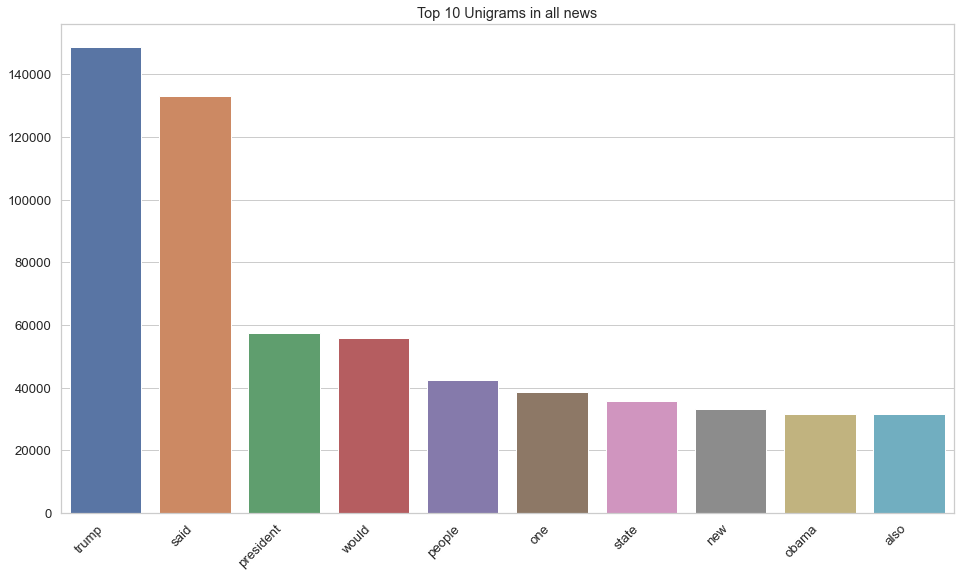

In [43]:
# Unigram (1 word sequence) Analysis
plt.figure(figsize = (16, 9))
top_unigrams = top_ngrams(df_allnews.clean, 10, 1)
unigram_chart = dict(top_unigrams)
unigram_chart = sns.barplot(x = list(unigram_chart.keys()), y = list(unigram_chart.values()))
unigram_chart.set_xticklabels(unigram_chart.get_xticklabels(), rotation = 45, horizontalalignment = 'right')
unigram_chart.set_title("Top 10 Unigrams in all news")
plt.show()

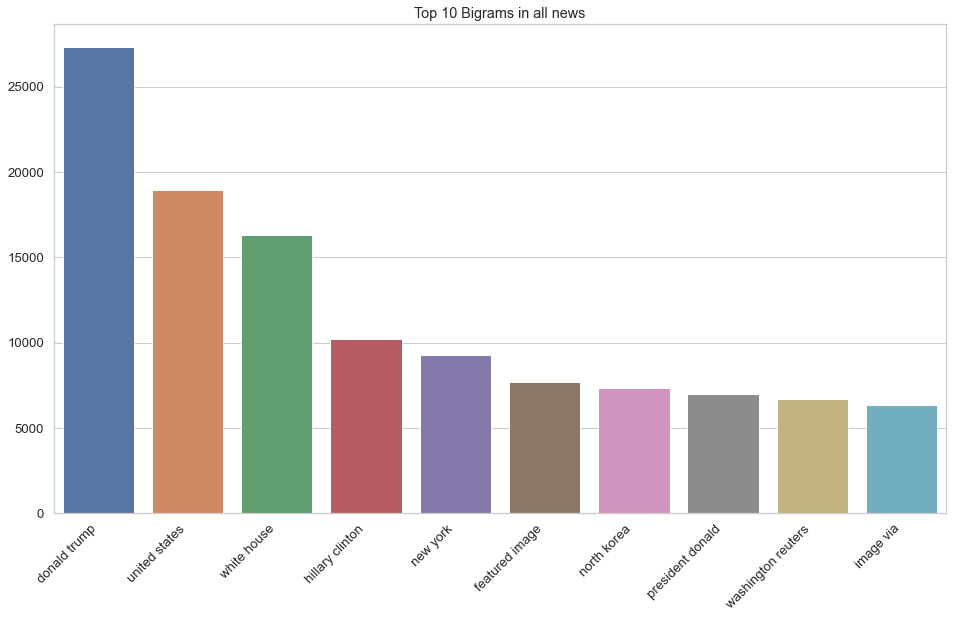

In [44]:
# Bigram (2 word sequence) Analysis
plt.figure(figsize = (16, 9))
top_bigrams = top_ngrams(df_allnews.clean, 10, 2)
bigram_chart = dict(top_bigrams)
bigram_chart = sns.barplot(x = list(bigram_chart.keys()), y = list(bigram_chart.values()))
bigram_chart.set_xticklabels(bigram_chart.get_xticklabels(), rotation = 45, horizontalalignment = 'right')
bigram_chart.set_title("Top 10 Bigrams in all news")
plt.show()

Text(0.5, 1.0, 'Top 10 Trigrams in all news')

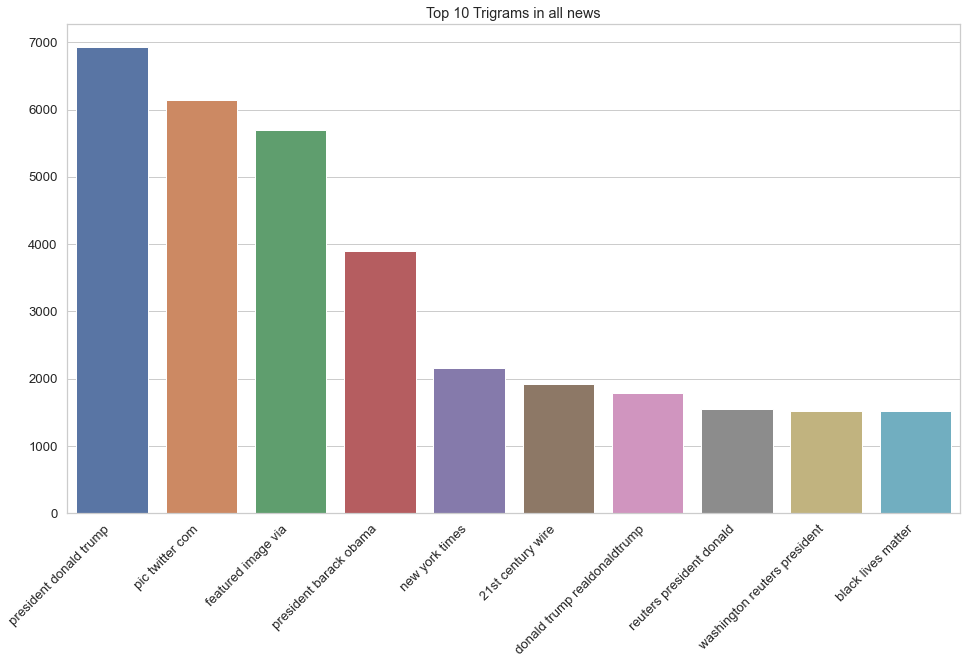

In [45]:
# Trigram (3 word sequence) Analysis
plt.figure(figsize = (16, 9))
top_trigrams = top_ngrams(df_allnews.clean, 10, 3)
trigram_chart = dict(top_trigrams)
trigram_chart = sns.barplot(x = list(trigram_chart.keys()), y = list(trigram_chart.values()))
trigram_chart.set_xticklabels(trigram_chart.get_xticklabels(), rotation = 45, horizontalalignment = 'right')
trigram_chart.set_title("Top 10 Trigrams in all news")

- Notice what the most frequently mentioned word(s) is(are). Surprised? :-P

**Modeling with Neural Networks**

In [46]:
# Splitting data into train (80%) and test (20%) sets, x/input is the 'clean' column data, 
# y/target/output is ithe sfake column data (what we are predicting)
x_train, X_test, y_train, y_test = train_test_split(df_allnews.clean, df_allnews.isfake, test_size = 0.2)

In [47]:
# Creating a tokenizer to break up (tokenize) the words into a sequences of tokenized words

# Defining some parameters
max_features = 100000
maxlength = 40

tokenizer = Tokenizer(num_words = max_features) 
tokenizer.fit_on_texts(x_train) # Creates the vocabulary
tokenized_train = tokenizer.texts_to_sequences(x_train) # Creates the sequence of integers

# Adding padding can either be maxlength = 4406 (from above) or smaller number maxlength = 40 seems to work 
# well based on results
# Pad sequences make all news articles the same length 
x_train = pad_sequences(tokenized_train, maxlen = maxlength, padding = 'post', truncating = 'post')

In [48]:
# Let's do the same thing but tokenize the test data
tokenized_test = tokenizer.texts_to_sequences(X_test) # Creates the sequence of integers
X_test = pad_sequences(tokenized_test, maxlen = maxlength, truncating = 'post')

In [49]:
# Lets compare the cleaned article to the tokenized and padded article
print("The encoding for document: \n\n", df_allnews.clean[0], "\n\nis:\n\n", x_train[0])

The encoding for document: 

 u.s. budget fight looms, republicans flip fiscal script washington (reuters) head conservative republican faction u.s. congress, voted month huge expansion national debt pay tax cuts, called “fiscal conservative” sunday urged budget restraint 2018. keeping sharp pivot way among republicans, u.s. representative mark meadows, speaking cbs’ “face nation,” drew hard line federal spending, lawmakers bracing battle january. return holidays wednesday, lawmakers begin trying pass federal budget fight likely linked issues, immigration policy, even november congressional election campaigns approach republicans seek keep control congress. president donald trump republicans want big budget increase military spending, democrats also want proportional increases non-defense “discretionary” spending programs support education, scientific research, infrastructure, public health environmental protection. “the (trump) administration already willing say: ‘we’re going increase

**Training the model**

In [55]:
# Defining some more model parameters
batch_size = 64
epochs = 10
embedding_size = 128
val_split = 0.1

In [51]:
# ReduceLROnPlateau reduces the learning rate when a metric has stopped improving. 
# Models can often benefit from reducing the learning rate. This monitors the quantity, if there is no improvement 
# in the 'patience' parameter number of epochs, the learning rate is reduced.
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience = 2, 
                                            verbose=1,factor=0.5, min_lr=0.00001)

In [52]:
#Defining the Neural Network by initializing the sequential model
fakenews_model = Sequential()

# Adding the non-trainable embedding layer
fakenews_model.add(Embedding(max_features, output_dim = embedding_size, input_length = maxlength, trainable = False))
# fakenews_model.add(Embedding(total_words, output_dim = 240))

# Building a Bi-Directional RNN and LSTM model
fakenews_model.add(Bidirectional(LSTM(128)))

# Adding Dense layers
fakenews_model.add(Dense(128, activation = 'relu')) # adding 128 dense layers with relu activation 
# Output is only 1 neuron, why? Essentially doing binary classification with an output of 0 or 1
fakenews_model.add(Dense(1,activation= 'sigmoid')) # adding dense of 1 neuron with sigmoid activation
# compiling model with adam optimizer and binary crossentropy loss with metrics being accuracy
fakenews_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy']) 
fakenews_model.summary()

# have approx 13Mil trainable parameters
# embedding layer for dimensionality reduction
# LSTM layer (bidirectional layer)
# 2 dense layers

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 40, 128)           12800000  
_________________________________________________________________
bidirectional (Bidirectional (None, 256)               263168    
_________________________________________________________________
dense (Dense)                (None, 128)               32896     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 129       
Total params: 13,096,193
Trainable params: 296,193
Non-trainable params: 12,800,000
_________________________________________________________________


In [53]:
# Converting y_train to a NumPy array, this is an important step before passing to the model (only accepts as an array)
y_train = np.asarray(y_train)
y_test = np.asarray(y_test)

In [56]:
# train the model
# input - x_train, output - y_train
# Validation set as 10% of training data for cross validation, 90% for training
# Running 10 epochs 
# if error is going down on both training and validation, thats good, it means model is able to generalize
# if error is going down for training but going up in validation, it means the model is overfitting the training data
model_history = fakenews_model.fit(x_train, y_train, batch_size = batch_size, validation_split = val_split, 
                                   epochs = epochs, callbacks = [learning_rate_reduction])

# Notice that the performance is amazing! Accuracy ~99% for both. Both losses also drop.

Train on 32326 samples, validate on 3592 samples
Epoch 1/10
32326/32326 [==============================] - 104s 3ms/sample - loss: 0.0646 - accuracy: 0.9784 - val_loss: 0.0237 - val_accuracy: 0.9972
Epoch 2/10
32326/32326 [==============================] - 104s 3ms/sample - loss: 0.0133 - accuracy: 0.9975 - val_loss: 0.0161 - val_accuracy: 0.9975
Epoch 3/10
32326/32326 [==============================] - 105s 3ms/sample - loss: 0.0107 - accuracy: 0.9979 - val_loss: 0.0153 - val_accuracy: 0.9972
Epoch 4/10
32320/32326 [============================>.] - ETA: 0s - loss: 0.0137 - accuracy: 0.9975
Epoch 00004: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
32326/32326 [==============================] - 105s 3ms/sample - loss: 0.0137 - accuracy: 0.9975 - val_loss: 0.0168 - val_accuracy: 0.9967
Epoch 5/10
32326/32326 [==============================] - 104s 3ms/sample - loss: 0.0086 - accuracy: 0.9981 - val_loss: 0.0147 - val_accuracy: 0.9969
Epoch 6/10
32320/32326 [========

**Evaluating the results after training the model**

In [59]:
# Checking the accuracy (percent) of the model on the train data
results_train = fakenews_model.evaluate(x_train, y_train, verbose = 0)
print("The accuracy of the model on training data is: " , results_train[1]*100, "%")

The accuracy of the model on training data is:  99.92204308509827 %


In [60]:
# Checking the accuracy (percent) of the model on the test data
results_test = fakenews_model.evaluate(X_test, y_test, verbose = 0)
print("The accuracy of the model on testing data is: " , results_test[1]*100, "%")

The accuracy of the model on testing data is:  99.85523223876953 %


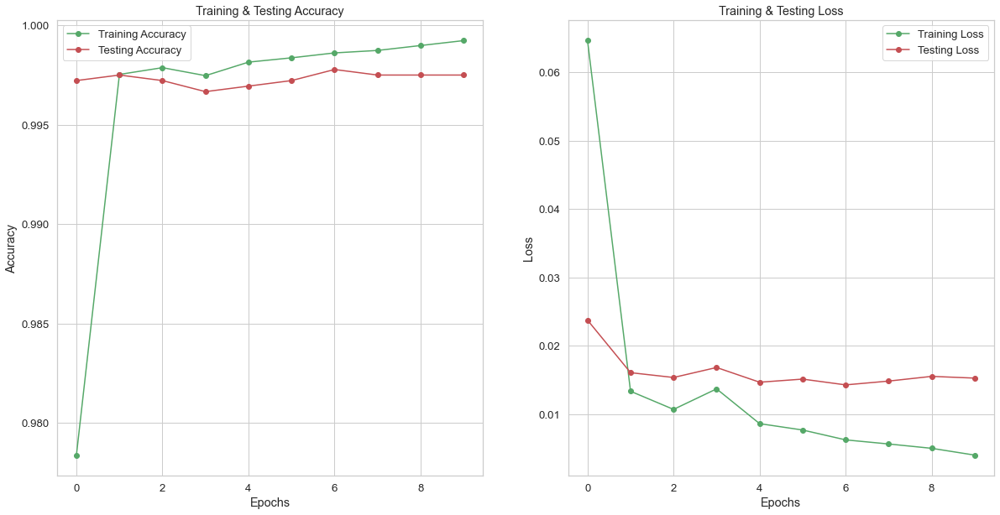

In [62]:
# Plotting the epochs vs all the predicted scores from the model
epochs = [i for i in range(10)]
fig , ax = plt.subplots(1,2)
train_acc = fakenews_model.history.history['accuracy']
train_loss = fakenews_model.history.history['loss']
val_acc = fakenews_model.history.history['val_accuracy']
val_loss = fakenews_model.history.history['val_loss']
fig.set_size_inches(20,10)

ax[0].plot(epochs , train_acc , 'go-' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'ro-' , label = 'Testing Accuracy')
ax[0].set_title('Training & Testing Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'go-' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'ro-' , label = 'Testing Loss')
ax[1].set_title('Training & Testing Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
plt.show()

In [63]:
# Checking prediction scores from the model
prediction = fakenews_model.predict_classes(X_test)
prediction[:5]

array([[1],
       [1],
       [0],
       [0],
       [1]], dtype=int32)

In [64]:
# Printing out scores
print(classification_report(y_test, prediction, target_names = ['Fake','Not Fake']))

              precision    recall  f1-score   support

        Fake       1.00      1.00      1.00      4250
    Not Fake       1.00      1.00      1.00      4730

    accuracy                           1.00      8980
   macro avg       1.00      1.00      1.00      8980
weighted avg       1.00      1.00      1.00      8980



In [65]:
# If the predicted value is > 0.5 it is real else it is fake
pred_vals = []
for i in range(len(prediction)):
    if prediction[i].item() > 0.5:
        pred_vals.append(1)
    else:
        pred_vals.append(0)

In [66]:
# Comparing accuracy between what was happening in reality (absolute truth, y_test) vs predictions (pred_vals)
# from sklearn.metrics import accuracy_score
accuracy = accuracy_score(list(y_test), pred_vals)
print("Model Accuracy : ", accuracy)

# 99% accuracy on testing data 

Model Accuracy :  0.9985523385300669


In [67]:
# Creating the confusion matrix 
cm = confusion_matrix(list(y_test), pred_vals)
cm

array([[4239,   11],
       [   2, 4728]])

In [68]:
# Making the confusion matrix look nice
cm = pd.DataFrame(cm , index = ['Fake','Real'] , columns = ['Fake','Real'])
cm

,Fake,Real
Fake,4239,11
Real,2,4728


Text(64.5, 0.5, 'Actual')

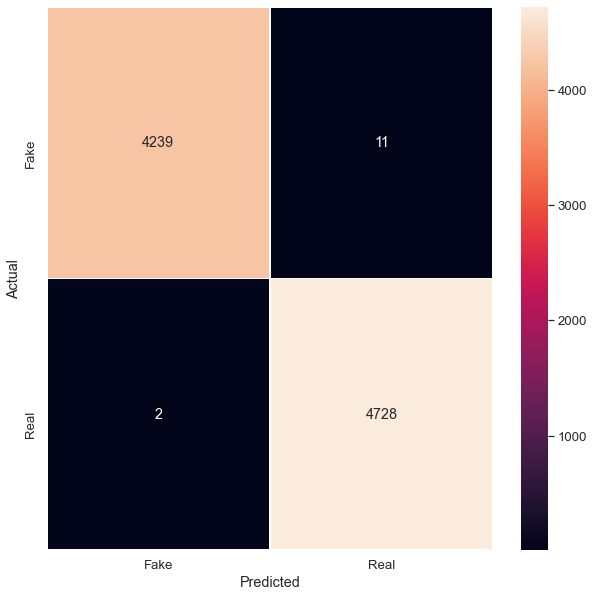

In [69]:
# Getting the confusion matrix to visualize predictions vs reality
# if predictions (1) match reality (1) for truth, then we have TPs
# if predictions is 0 and matches reality of 0, then we have TNs
# notice we misclassified 9 samples as FN and 13 samples as FP
# from sklearn.metrics import confusion_matrix
cm = confusion_matrix(list(y_test), pred_vals)
plt.figure(figsize = (10, 10))
sns.heatmap(cm, linewidth = 1, annot = True, fmt = '', xticklabels = ['Fake', 'Real'], 
            yticklabels = ['Fake', 'Real'])
plt.xlabel("Predicted")
plt.ylabel("Actual")